In [1]:
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
from torch.nn.functional import relu
from torch.utils.data import DataLoader
from torchvision import transforms
from torchsummary import summary
import warnings
warnings.filterwarnings('ignore')

In [7]:
from datasets import load_dataset

ds = load_dataset("huggan/wikiart", split="train")

Resolving data files:   0%|          | 0/72 [00:00<?, ?it/s]

Loading dataset shards:   0%|          | 0/45 [00:00<?, ?it/s]

In [9]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print('Using gpu: %s ' % torch.cuda.is_available())

Using gpu: False 


In [20]:
class WikiArtDataset(torch.utils.data.Dataset):
    def __init__(self, ds, transform=None):
        self.ds = ds
        self.transform = transform

    def __len__(self):
        return len(self.ds)

    def __getitem__(self, idx):
        sample = self.ds[idx]
        image = sample['image']
        label = sample['style']

        if self.transform:
            image = self.transform(image)

        return image, label

In [21]:
transform = transforms.Compose([
    transforms.Resize((64, 64)),
    #transforms.RandomHorizontalFlip(),  
    #transforms.RandomRotation(45),      
    #transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
])

wikiart_dataset = WikiArtDataset(ds, transform=transform)
dataloader = DataLoader(wikiart_dataset, batch_size=64, shuffle=True, num_workers=4)
print(len(dataloader.dataset))

81444


In [23]:
class Generator(nn.Module):
    def __init__(self, input_dim):
        super(Generator, self).__init__()
        self.fc1 = nn.Linear(input_dim, 512 * 4 * 4)
        #self.convT1 = nn.ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=2, padding=1)  
        self.convT2 = nn.ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=2, padding=1)   
        self.convT3 = nn.ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=2, padding=1)   
        self.convT4 = nn.ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=2, padding=1)    
        self.convT5 = nn.ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=2, padding=1)     
        self.sigmoid = nn.Sigmoid()
        self.tanh = nn.Tanh()

    def forward(self, x):
        x = relu(self.fc1(x))
        x = x.view(-1, 512, 4, 4)
    
        #x = relu(self.convT1(x))
        x = relu(self.convT2(x))
        x = relu(self.convT3(x))
        x = relu(self.convT4(x))
        x = self.convT5(x)

        x = self.tanh(x)
        
        return x


generator = Generator(input_dim=100).to(device)
summary(generator, (100,))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Linear-1                 [-1, 8192]         827,392
   ConvTranspose2d-2            [-1, 256, 8, 8]       2,097,408
   ConvTranspose2d-3          [-1, 128, 16, 16]         524,416
   ConvTranspose2d-4           [-1, 64, 32, 32]         131,136
   ConvTranspose2d-5            [-1, 3, 64, 64]           3,075
              Tanh-6            [-1, 3, 64, 64]               0
Total params: 3,583,427
Trainable params: 3,583,427
Non-trainable params: 0
----------------------------------------------------------------
Input size (MB): 0.00
Forward/backward pass size (MB): 1.12
Params size (MB): 13.67
Estimated Total Size (MB): 14.80
----------------------------------------------------------------


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99999857..0.99996096].


(np.float64(-0.5), np.float64(63.5), np.float64(63.5), np.float64(-0.5))

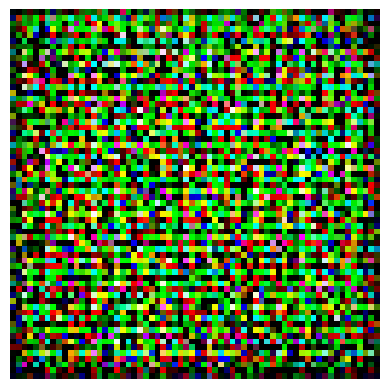

In [24]:
img = torch.rand(100).to(device) * 255
img = generator(img)[0]

img = img.detach().cpu().numpy()
plt.imshow(img.T)
plt.axis("off")

In [25]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.conv1 = nn.Conv2d(3, 64, kernel_size=(4, 4), stride=2, padding=1)  
        self.conv2 = nn.Conv2d(64, 128, kernel_size=(4, 4), stride=2, padding=1)
        self.conv3 = nn.Conv2d(128, 256, kernel_size=(4, 4), stride=2, padding=1)
        self.fc1 = nn.Linear(256 * 8 * 8, 1) 
        self.lrelu = nn.LeakyReLU(0.2)
        self.dropout = nn.Dropout(0.3)
        self.bn1 = nn.BatchNorm2d(128)
        self.bn2 = nn.BatchNorm2d(256)

    def forward(self, x):
        x = self.lrelu(self.conv1(x))
        x = self.lrelu(self.conv2(x))
        x = self.lrelu(self.conv3(x))
        x = x.view(x.size(0), -1)  
        #x = self.dropout(x)
        x = self.fc1(x)

        return x

discriminator = Discriminator().to(device)
summary(discriminator, (3, 64, 64))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 32, 32]           3,136
         LeakyReLU-2           [-1, 64, 32, 32]               0
            Conv2d-3          [-1, 128, 16, 16]         131,200
         LeakyReLU-4          [-1, 128, 16, 16]               0
            Conv2d-5            [-1, 256, 8, 8]         524,544
         LeakyReLU-6            [-1, 256, 8, 8]               0
            Linear-7                    [-1, 1]          16,385
Total params: 675,265
Trainable params: 675,265
Non-trainable params: 0
----------------------------------------------------------------
Input size (MB): 0.05
Forward/backward pass size (MB): 1.75
Params size (MB): 2.58
Estimated Total Size (MB): 4.37
----------------------------------------------------------------


In [26]:
g_opt = torch.optim.Adam(lr=1e-4, betas=(0.5, 0.999), params=generator.parameters())
d_opt = torch.optim.Adam(lr=1e-4, betas=(0.5, 0.999), params=discriminator.parameters())

In [44]:
nb_epochs = 100
batch_size = 64

In [45]:
criterion = nn.BCEWithLogitsLoss()

In [46]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
        nn.init.constant_(m.bias.data, 0)


In [47]:
generator.apply(weights_init)
discriminator.apply(weights_init)

Discriminator(
  (conv1): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (conv2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (conv3): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (fc1): Linear(in_features=16384, out_features=1, bias=True)
  (lrelu): LeakyReLU(negative_slope=0.2)
  (dropout): Dropout(p=0.3, inplace=False)
  (bn1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (bn2): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
)

In [48]:
import os
import torchvision.utils as vutils
os.makedirs('generated_images', exist_ok=True)

In [49]:
def train(train_loader, nb_epochs, batch_size, generator, discriminator, input_dim, device):
    for epoch in (range(nb_epochs)):
        total_d_loss = 0.0
        total_g_loss = 0.0

        for batch_idx, (real_images, _) in enumerate(train_loader):
            real_images = real_images.to(device)
            m = real_images.size(0)
            # Train Discriminator
            d_opt.zero_grad()
            real_labels = torch.ones(m).to(device)
            fake_labels = torch.zeros(m).to(device)
            
            outputs_real = discriminator(real_images).view(-1)
            d_loss_real = criterion(outputs_real, real_labels)

            noise = torch.randn(m, input_dim, device=device)
            fake_images = generator(noise)
            outputs_fake = discriminator(fake_images.detach()).view(-1)
            d_loss_fake = criterion(outputs_fake, fake_labels)

            d_loss = d_loss_real + d_loss_fake
            d_loss.backward()
            d_opt.step()
            total_d_loss += d_loss.item()

            # Entraînement du générateur
            g_opt.zero_grad()
            g_labels = torch.ones(m, device=device)
            outputs = discriminator(fake_images).view(-1)
            g_loss = criterion(outputs, g_labels)
            g_loss.backward()
            g_opt.step()
            total_g_loss += g_loss.item()

        avg_d_loss = total_d_loss / len(train_loader)
        avg_g_loss = total_g_loss / len(train_loader)

        g_loss_h.append(avg_g_loss)
        d_loss_h.append(avg_d_loss)
        print(f"Epoch [{epoch+1}/{nb_epochs}], Discriminator Loss: {avg_d_loss:.4f}, Generator Loss: {avg_g_loss:.4f}")

        with torch.no_grad():
            noise = torch.randn(6, input_dim, device=device)  
            generated_images = generator(noise)
            generated_images = (generated_images + 1) / 2 

            # Sauvegarder les images générées en les empilant
            vutils.save_image(generated_images, f"generated_images/epoch_{epoch+1}.png", nrow=3, normalize=True)

            # Si tu veux afficher les images dans le notebook
            grid_img = vutils.make_grid(generated_images.cpu(), nrow=3)
            plt.imshow(grid_img.permute(1, 2, 0))
            plt.axis("off")
            plt.show()

Epoch [1/100], Discriminator Loss: 0.6651, Generator Loss: 3.3246


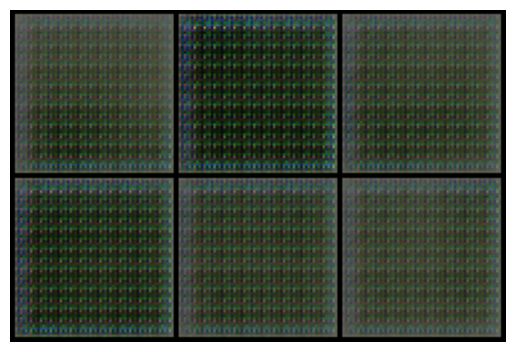

Epoch [2/100], Discriminator Loss: 0.9665, Generator Loss: 1.8837


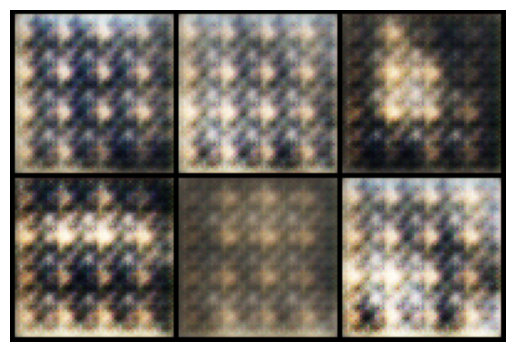

Epoch [3/100], Discriminator Loss: 1.0691, Generator Loss: 1.4836


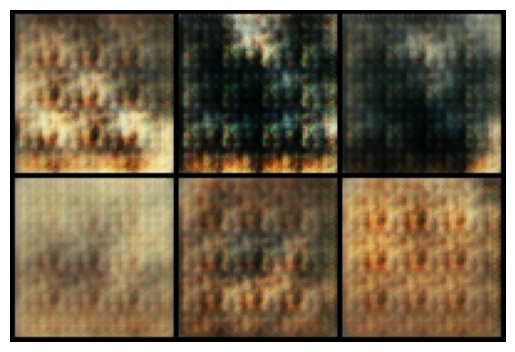

Epoch [4/100], Discriminator Loss: 0.9239, Generator Loss: 1.8345


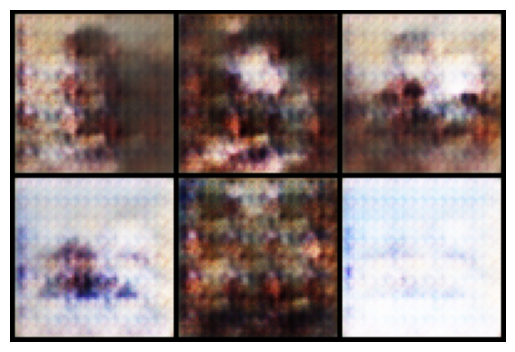

Epoch [5/100], Discriminator Loss: 0.9511, Generator Loss: 1.8692


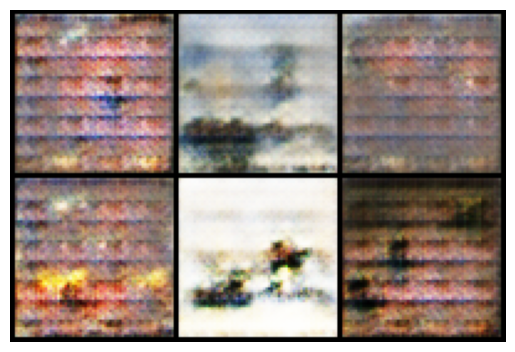

Epoch [6/100], Discriminator Loss: 0.9536, Generator Loss: 1.7059


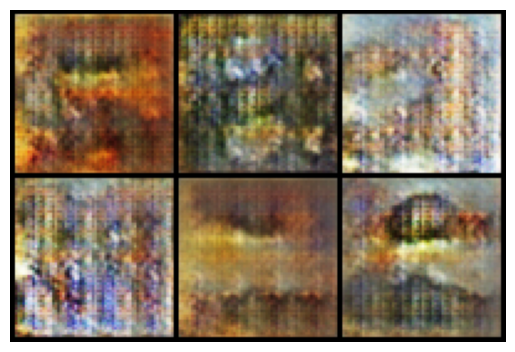

Epoch [7/100], Discriminator Loss: 1.0537, Generator Loss: 1.3834


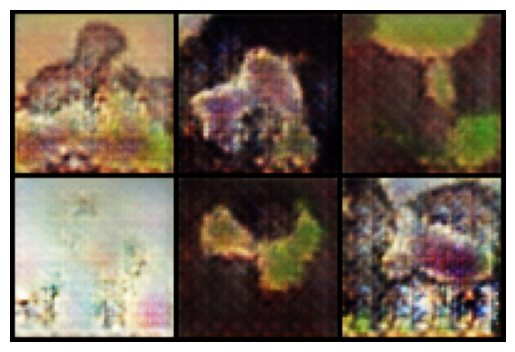

Epoch [8/100], Discriminator Loss: 1.0825, Generator Loss: 1.2909


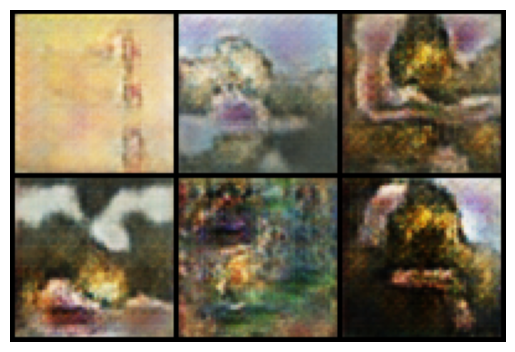

Epoch [9/100], Discriminator Loss: 1.1068, Generator Loss: 1.2473


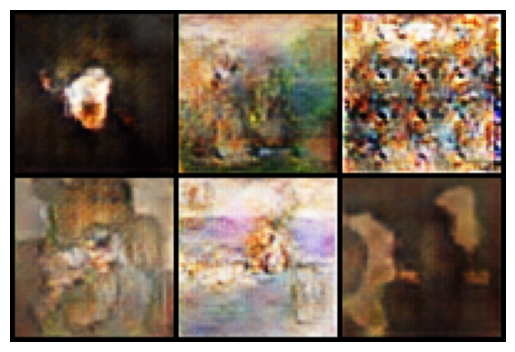

Epoch [10/100], Discriminator Loss: 1.1248, Generator Loss: 1.2442


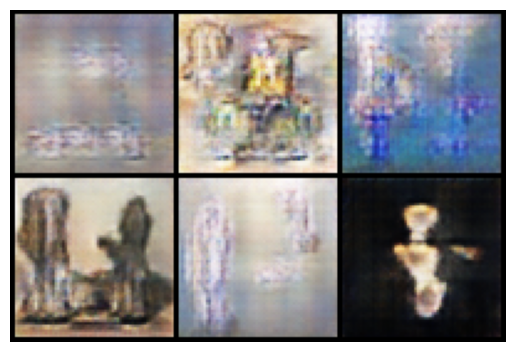

Epoch [11/100], Discriminator Loss: 1.1274, Generator Loss: 1.2201


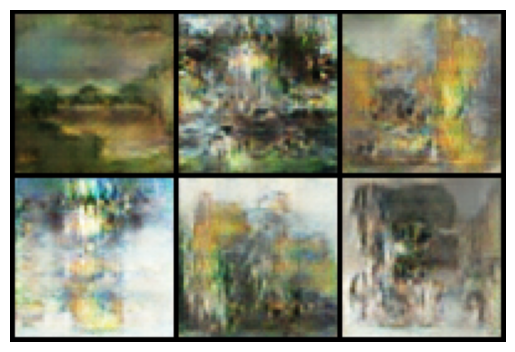

Epoch [12/100], Discriminator Loss: 1.1308, Generator Loss: 1.1838


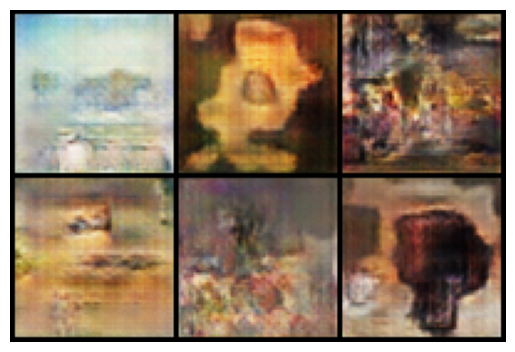

Epoch [13/100], Discriminator Loss: 1.1111, Generator Loss: 1.2087


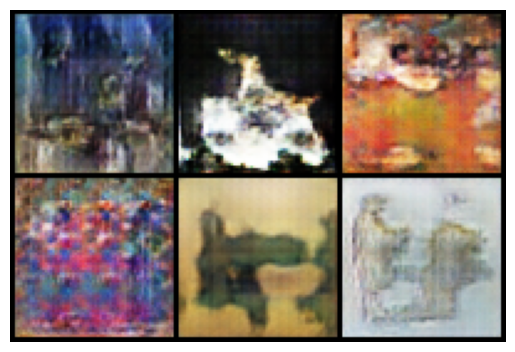

Epoch [14/100], Discriminator Loss: 1.1238, Generator Loss: 1.1863


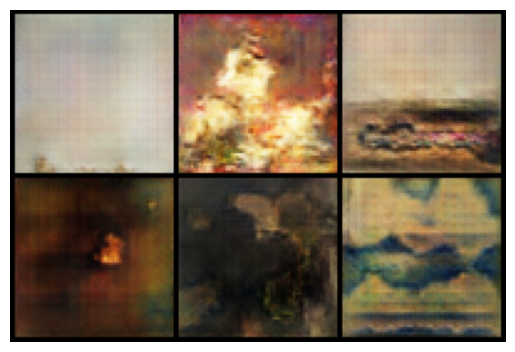

Epoch [15/100], Discriminator Loss: 1.1309, Generator Loss: 1.1409


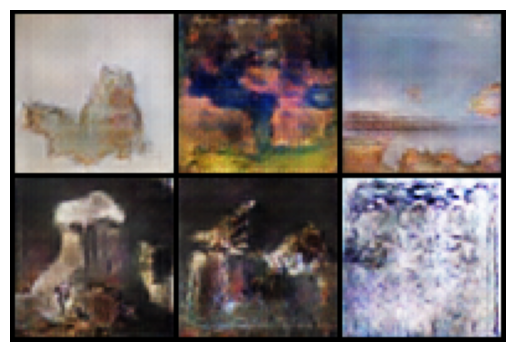

Epoch [16/100], Discriminator Loss: 1.1226, Generator Loss: 1.1389


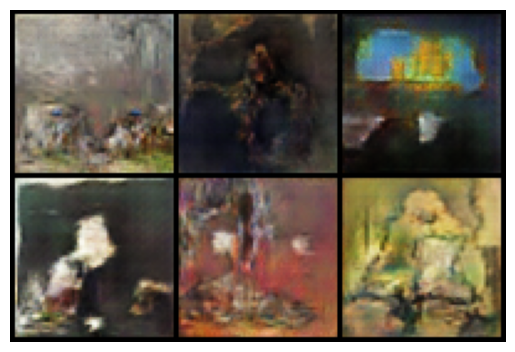

Epoch [17/100], Discriminator Loss: 1.1210, Generator Loss: 1.1566


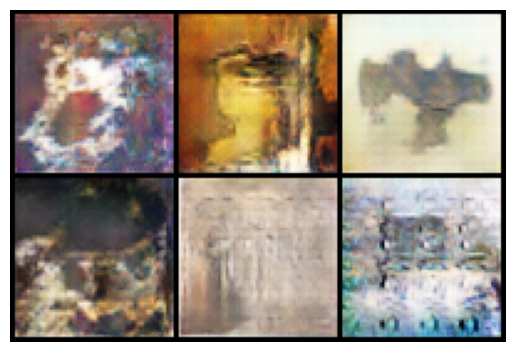

Epoch [18/100], Discriminator Loss: 1.1364, Generator Loss: 1.1483


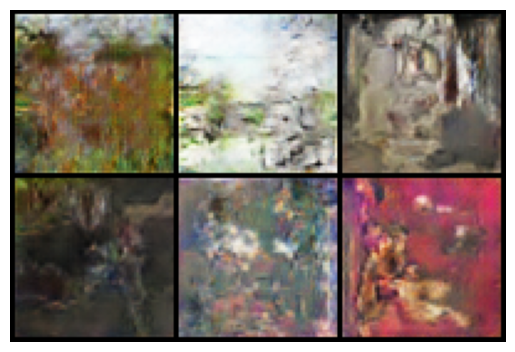

Epoch [19/100], Discriminator Loss: 1.1362, Generator Loss: 1.1293


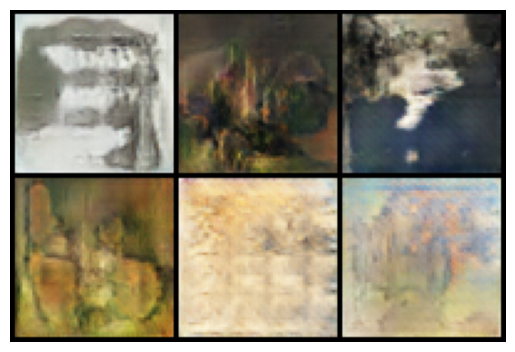

Epoch [20/100], Discriminator Loss: 1.1406, Generator Loss: 1.1332


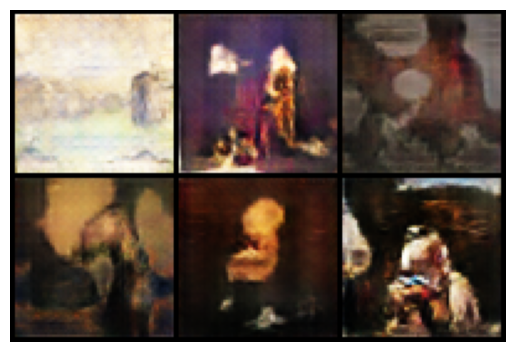

Epoch [21/100], Discriminator Loss: 1.1340, Generator Loss: 1.1335


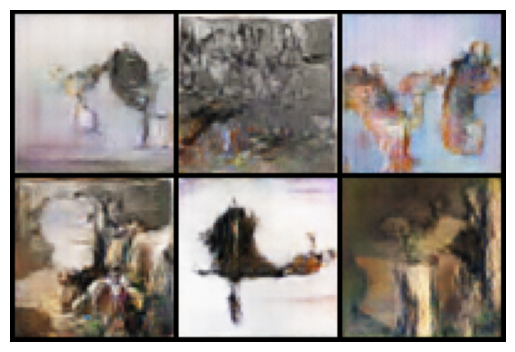

Epoch [22/100], Discriminator Loss: 1.1258, Generator Loss: 1.1400


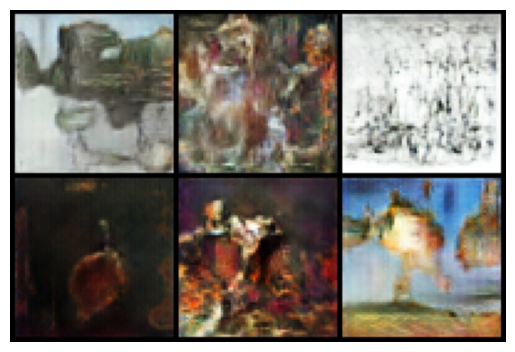

Epoch [23/100], Discriminator Loss: 1.1281, Generator Loss: 1.1314


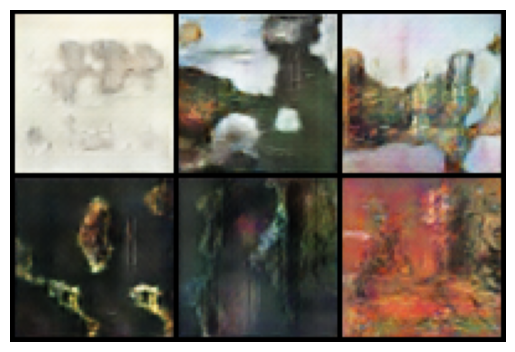

Epoch [24/100], Discriminator Loss: 1.1250, Generator Loss: 1.1305


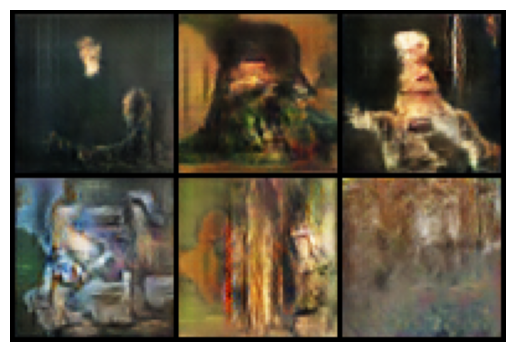

Epoch [25/100], Discriminator Loss: 1.1272, Generator Loss: 1.1319


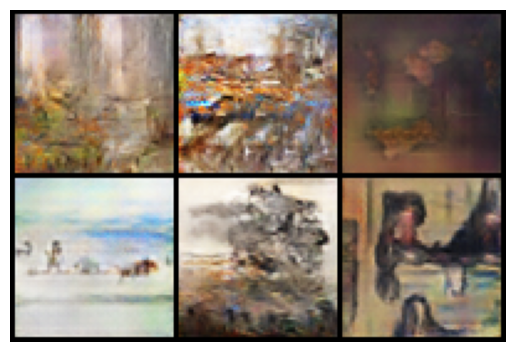

Epoch [26/100], Discriminator Loss: 1.1332, Generator Loss: 1.1242


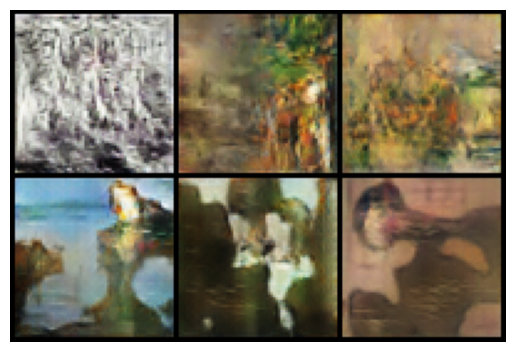

Epoch [27/100], Discriminator Loss: 1.1320, Generator Loss: 1.1240


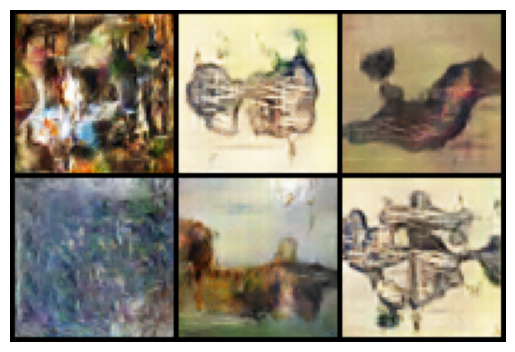

Epoch [28/100], Discriminator Loss: 1.1355, Generator Loss: 1.1184


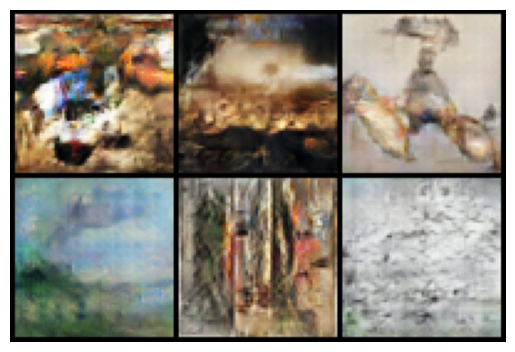

Epoch [29/100], Discriminator Loss: 1.1389, Generator Loss: 1.1167


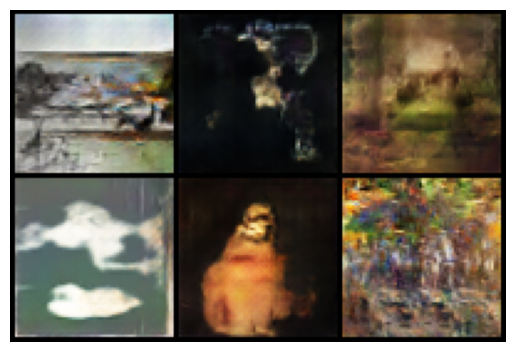

Epoch [30/100], Discriminator Loss: 1.1384, Generator Loss: 1.1023


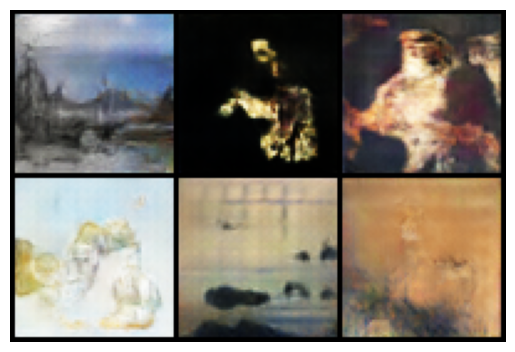

Epoch [31/100], Discriminator Loss: 1.1407, Generator Loss: 1.0991


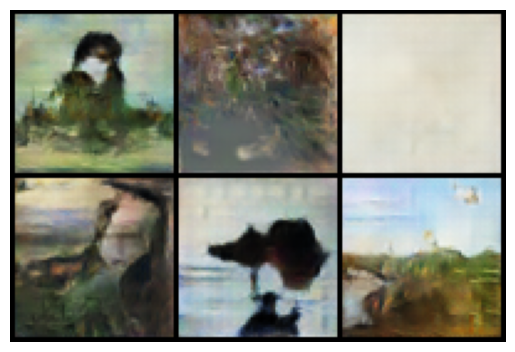

Epoch [32/100], Discriminator Loss: 1.1379, Generator Loss: 1.1020


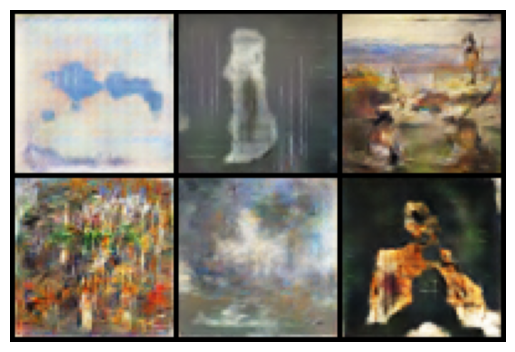

Epoch [33/100], Discriminator Loss: 1.1321, Generator Loss: 1.1158


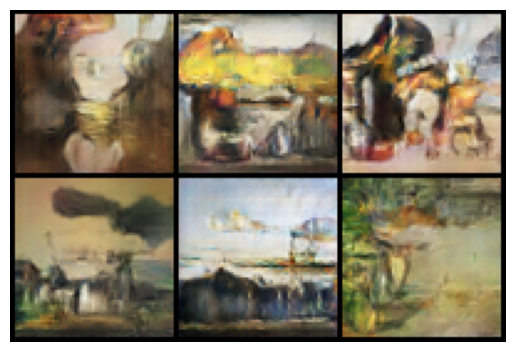

Epoch [34/100], Discriminator Loss: 1.1292, Generator Loss: 1.1143


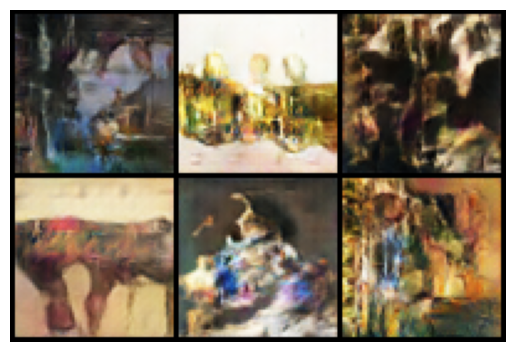

Epoch [35/100], Discriminator Loss: 1.1221, Generator Loss: 1.1111


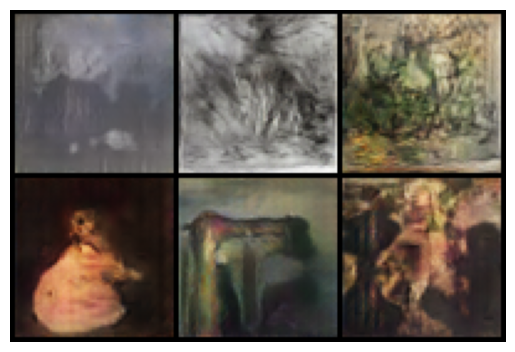

Epoch [36/100], Discriminator Loss: 1.1484, Generator Loss: 1.1148


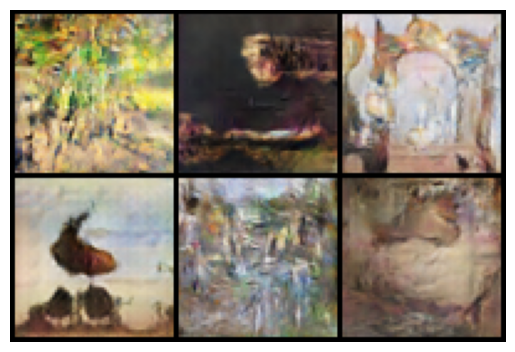

Epoch [37/100], Discriminator Loss: 1.1230, Generator Loss: 1.1060


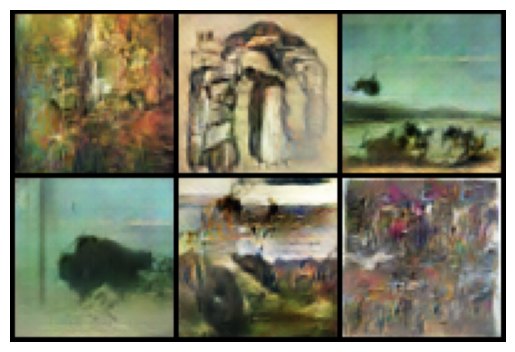

Epoch [38/100], Discriminator Loss: 1.1243, Generator Loss: 1.1120


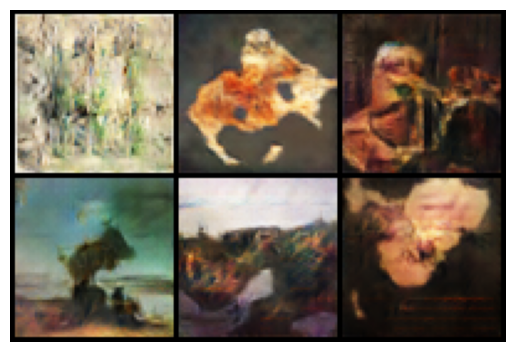

Epoch [39/100], Discriminator Loss: 1.1211, Generator Loss: 1.1185


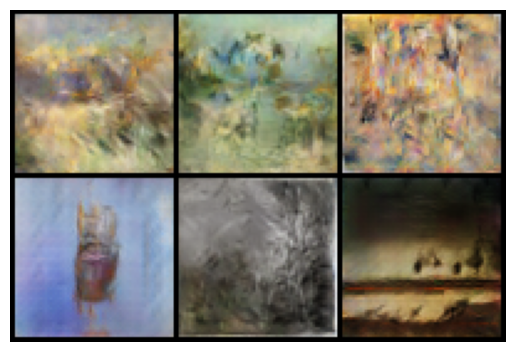

Epoch [40/100], Discriminator Loss: 1.1190, Generator Loss: 1.1173


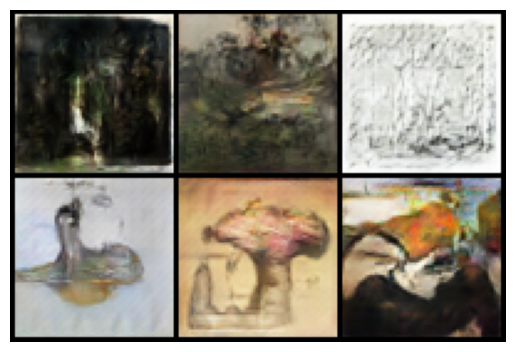

Epoch [41/100], Discriminator Loss: 1.1274, Generator Loss: 1.1222


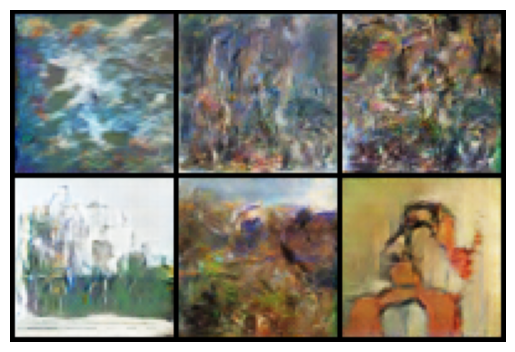

Epoch [42/100], Discriminator Loss: 1.1195, Generator Loss: 1.1231


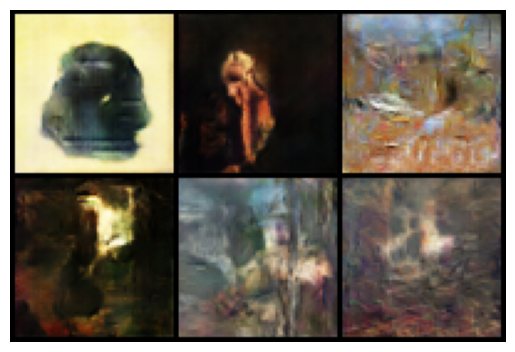

Epoch [43/100], Discriminator Loss: 1.1140, Generator Loss: 1.1263


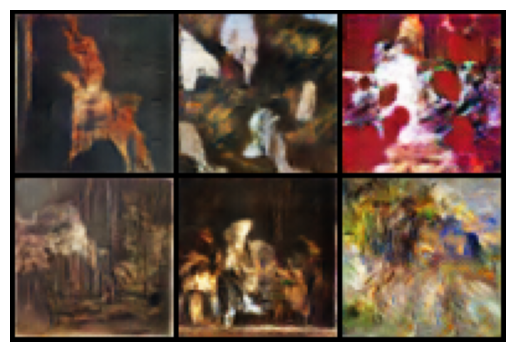

Epoch [44/100], Discriminator Loss: 1.1231, Generator Loss: 1.1205


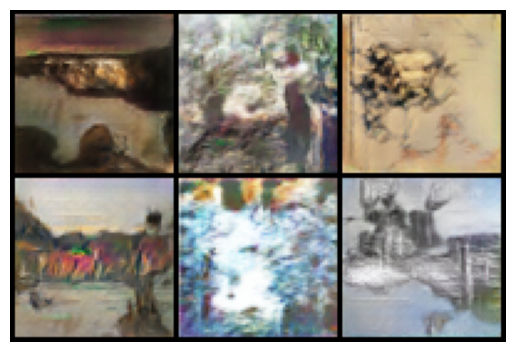

Epoch [45/100], Discriminator Loss: 1.1177, Generator Loss: 1.1227


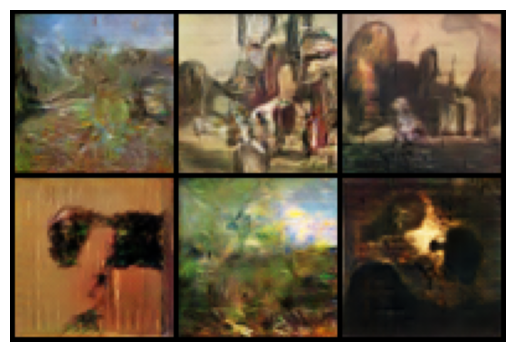

Epoch [46/100], Discriminator Loss: 1.1174, Generator Loss: 1.1223


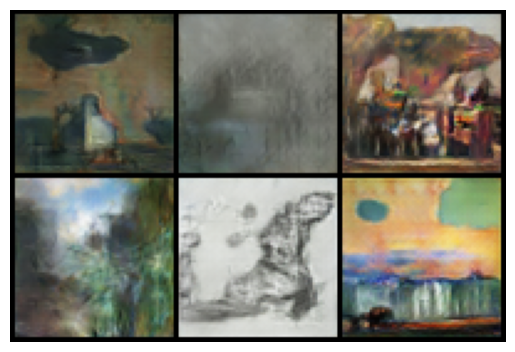

Epoch [47/100], Discriminator Loss: 1.1188, Generator Loss: 1.1168


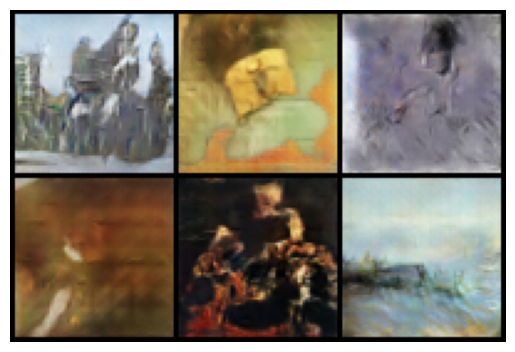

Epoch [48/100], Discriminator Loss: 1.1180, Generator Loss: 1.1218


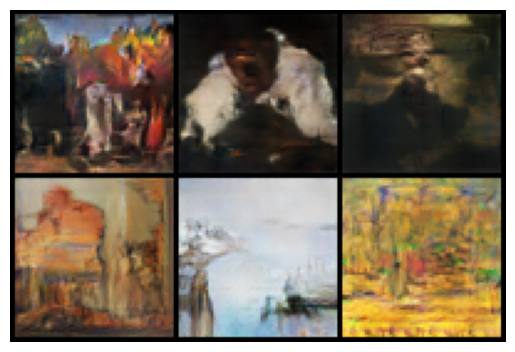

Epoch [49/100], Discriminator Loss: 1.1154, Generator Loss: 1.1231


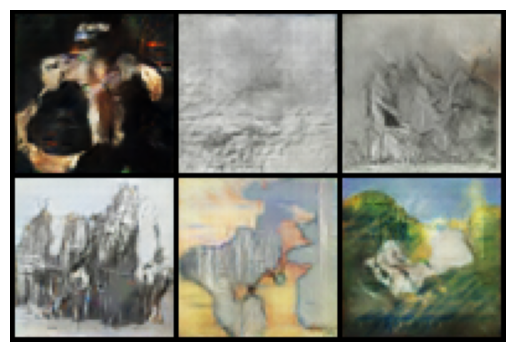

Epoch [50/100], Discriminator Loss: 1.1191, Generator Loss: 1.1184


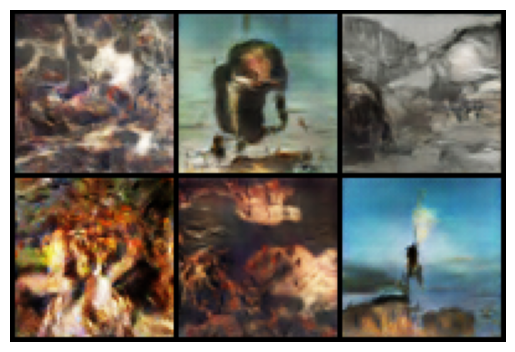

Epoch [51/100], Discriminator Loss: 1.1135, Generator Loss: 1.1270


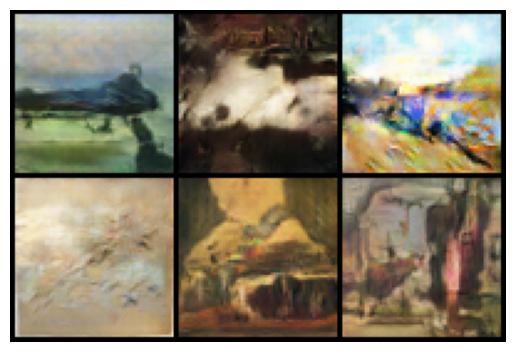

Epoch [52/100], Discriminator Loss: 1.1131, Generator Loss: 1.1225


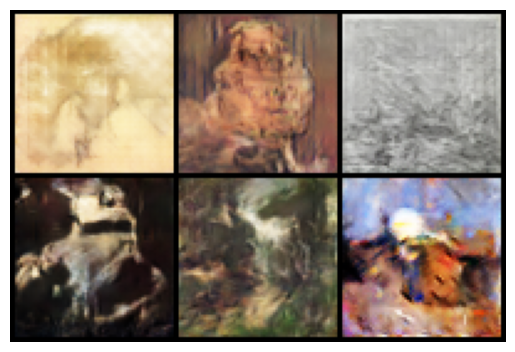

Epoch [53/100], Discriminator Loss: 1.1126, Generator Loss: 1.1275


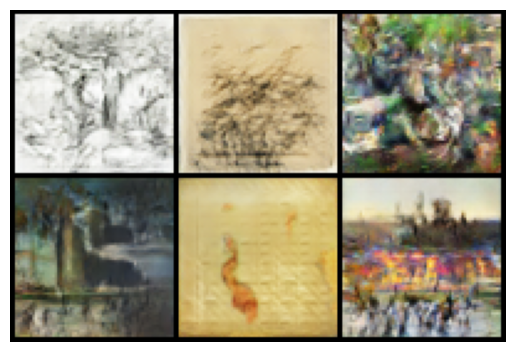

Epoch [54/100], Discriminator Loss: 1.1049, Generator Loss: 1.1372


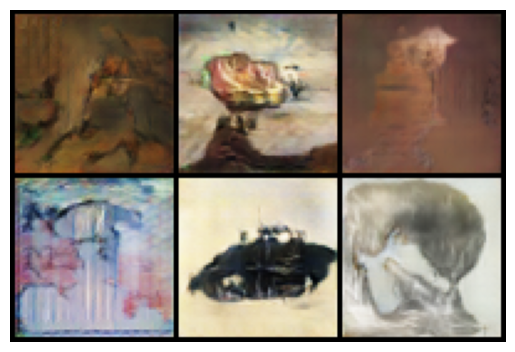

Epoch [55/100], Discriminator Loss: 1.1091, Generator Loss: 1.1271


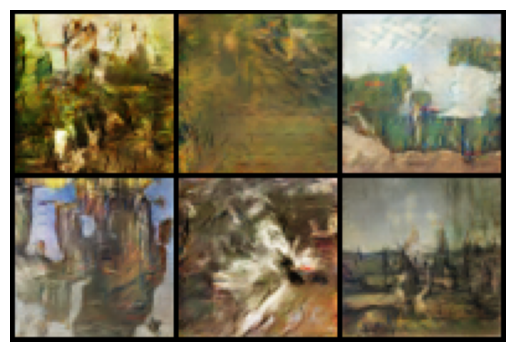

Epoch [56/100], Discriminator Loss: 1.1154, Generator Loss: 1.1292


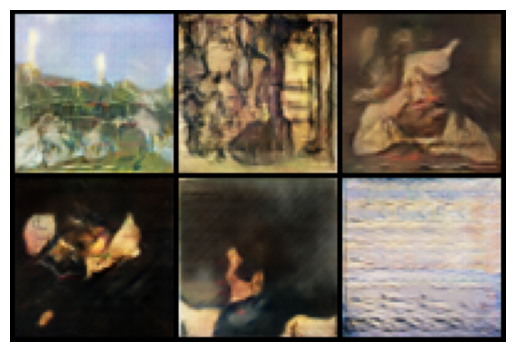

Epoch [57/100], Discriminator Loss: 1.1069, Generator Loss: 1.1367


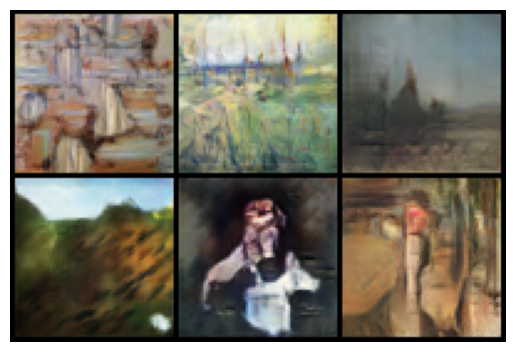

Epoch [58/100], Discriminator Loss: 1.1042, Generator Loss: 1.1383


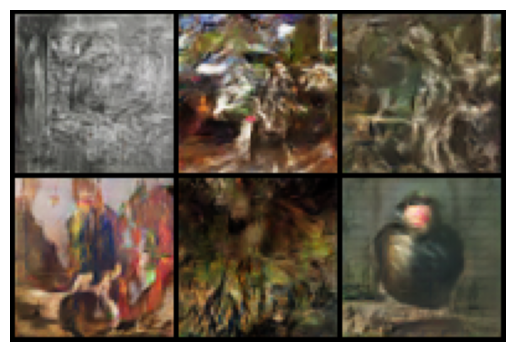

Epoch [59/100], Discriminator Loss: 1.1192, Generator Loss: 1.1424


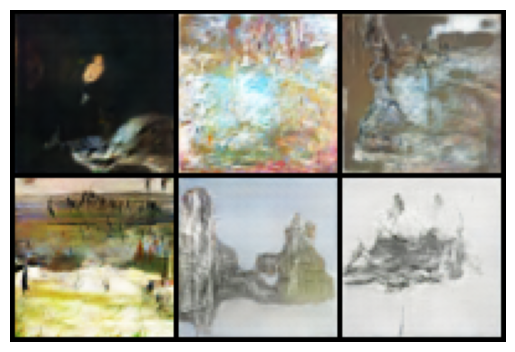

Epoch [60/100], Discriminator Loss: 1.0985, Generator Loss: 1.1335


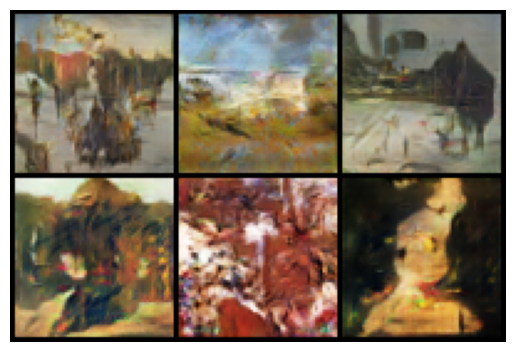

Epoch [61/100], Discriminator Loss: 1.1019, Generator Loss: 1.1461


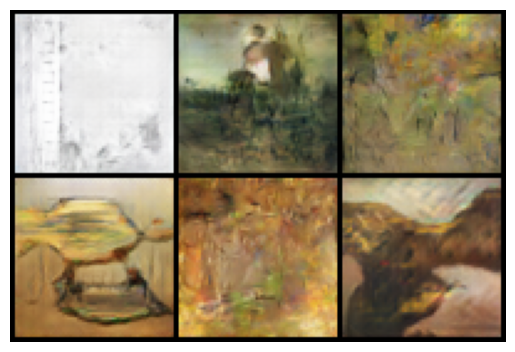

Epoch [62/100], Discriminator Loss: 1.1242, Generator Loss: 1.1328


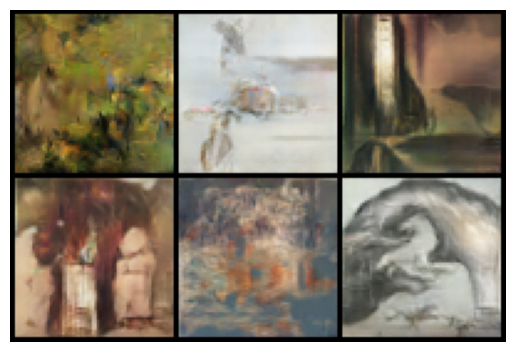

Epoch [63/100], Discriminator Loss: 1.1016, Generator Loss: 1.1353


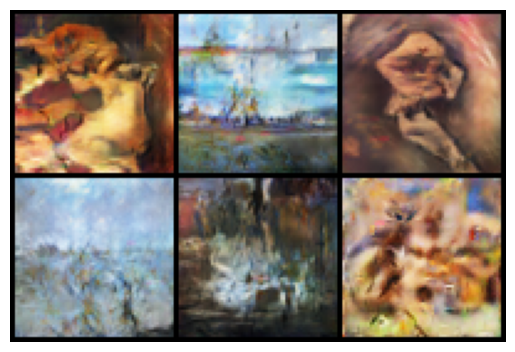

Epoch [64/100], Discriminator Loss: 1.1010, Generator Loss: 1.1432


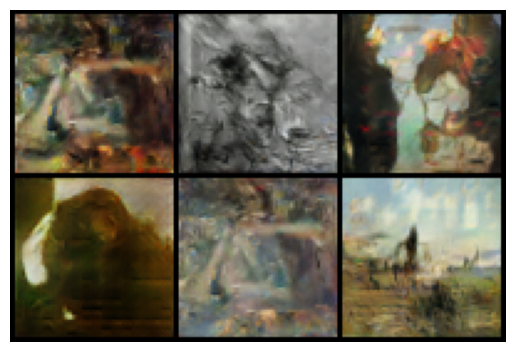

Epoch [65/100], Discriminator Loss: 1.1035, Generator Loss: 1.1441


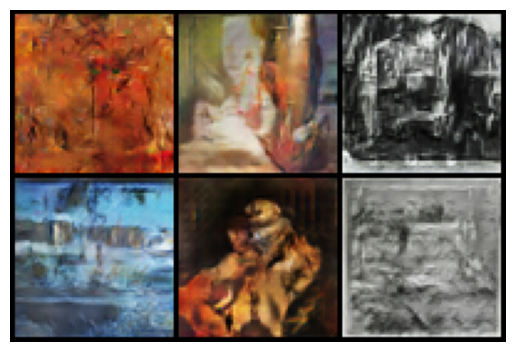

Epoch [66/100], Discriminator Loss: 1.1549, Generator Loss: 1.1187


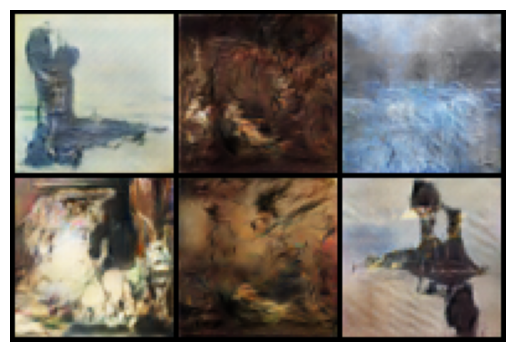

Epoch [67/100], Discriminator Loss: 1.0990, Generator Loss: 1.1319


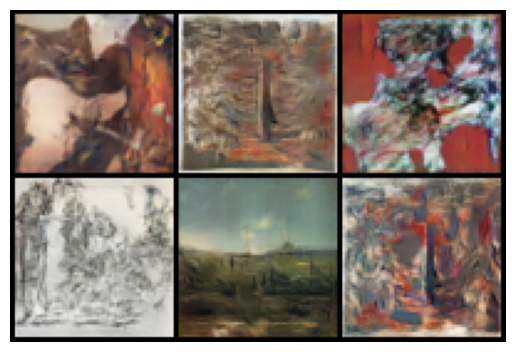

Epoch [68/100], Discriminator Loss: 1.0937, Generator Loss: 1.1481


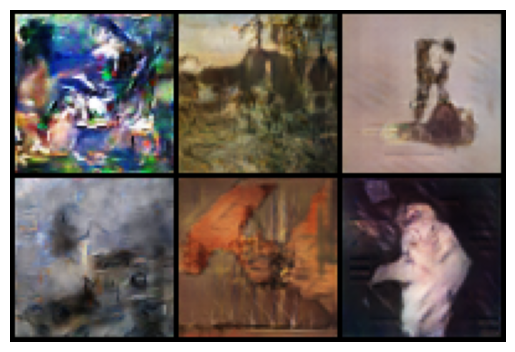

Epoch [69/100], Discriminator Loss: 1.0931, Generator Loss: 1.1644


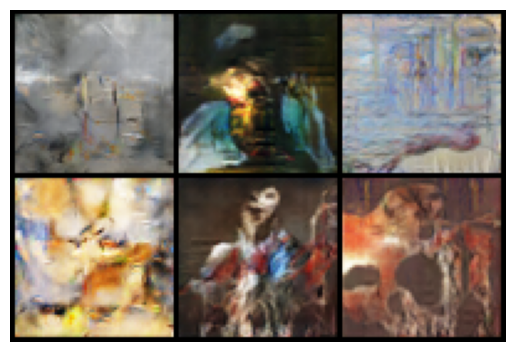

Epoch [70/100], Discriminator Loss: 1.0891, Generator Loss: 1.1646


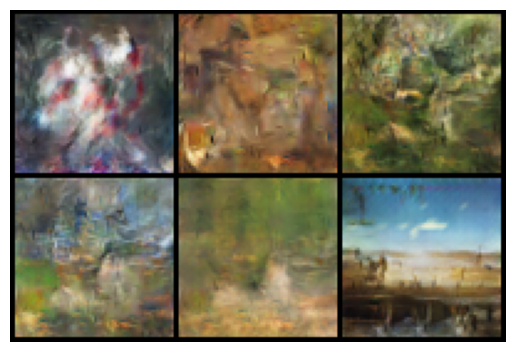

Epoch [71/100], Discriminator Loss: 1.1396, Generator Loss: 1.1584


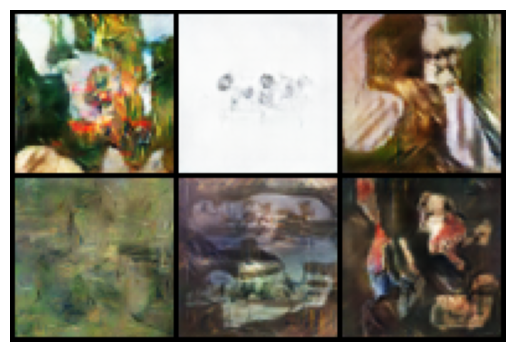

Epoch [72/100], Discriminator Loss: 1.0870, Generator Loss: 1.1371


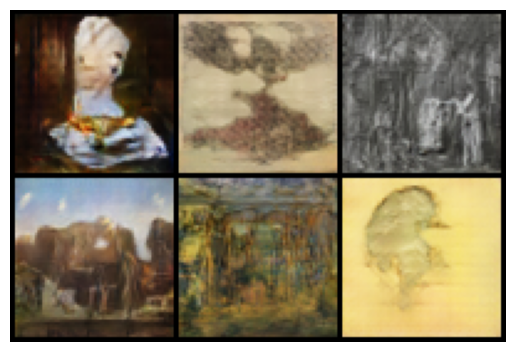

Epoch [73/100], Discriminator Loss: 1.0845, Generator Loss: 1.1658


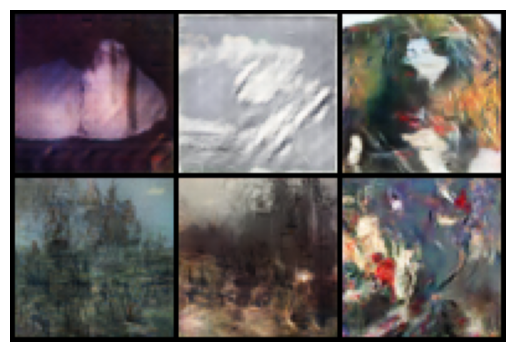

Epoch [74/100], Discriminator Loss: 1.0796, Generator Loss: 1.1758


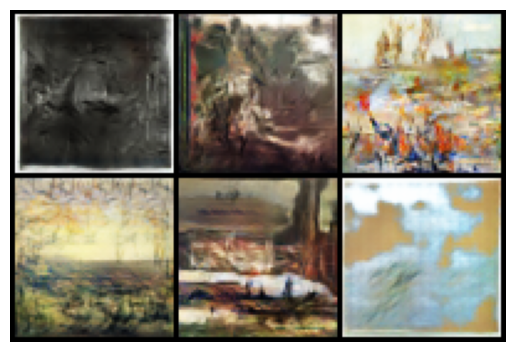

Epoch [75/100], Discriminator Loss: 1.0779, Generator Loss: 1.1765


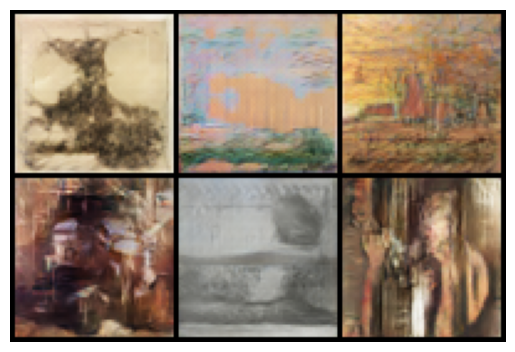

Epoch [76/100], Discriminator Loss: 1.0758, Generator Loss: 1.1840


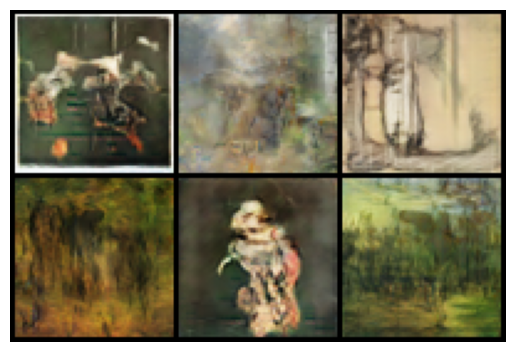

Epoch [77/100], Discriminator Loss: 1.0732, Generator Loss: 1.1814


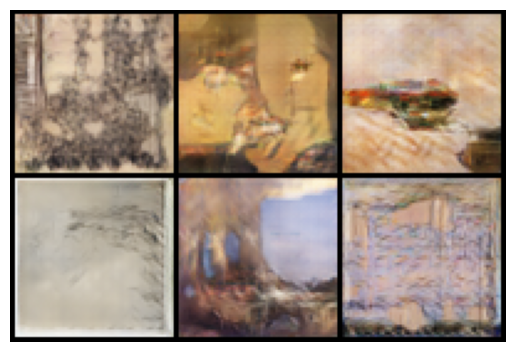

Epoch [78/100], Discriminator Loss: 1.0742, Generator Loss: 1.1858


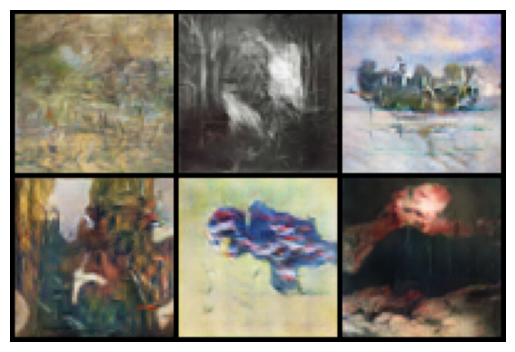

Epoch [79/100], Discriminator Loss: 1.0724, Generator Loss: 1.1823


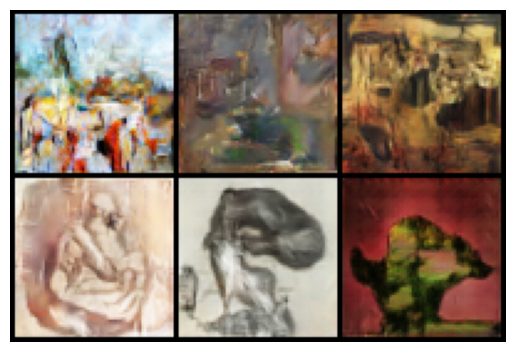

Epoch [80/100], Discriminator Loss: 1.0709, Generator Loss: 1.1907


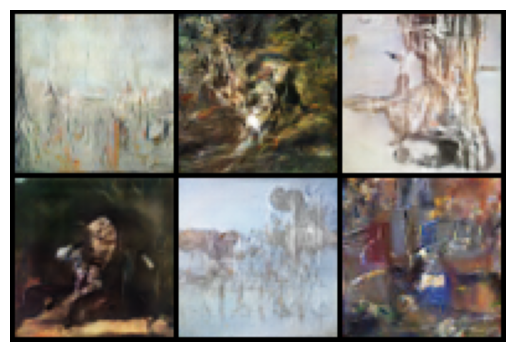

Epoch [81/100], Discriminator Loss: 1.1116, Generator Loss: 1.1778


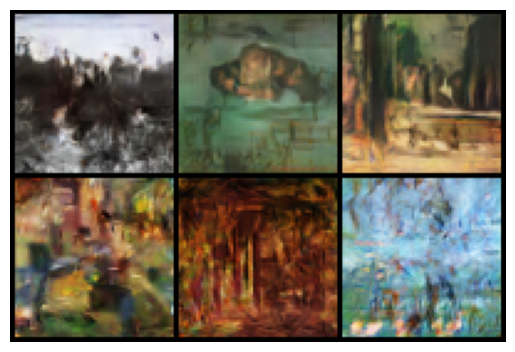

Epoch [82/100], Discriminator Loss: 1.0719, Generator Loss: 1.1811


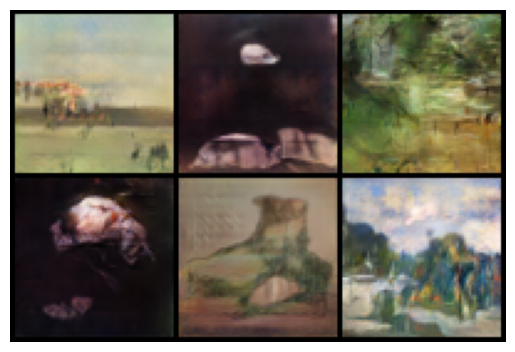

Epoch [83/100], Discriminator Loss: 1.0676, Generator Loss: 1.1915


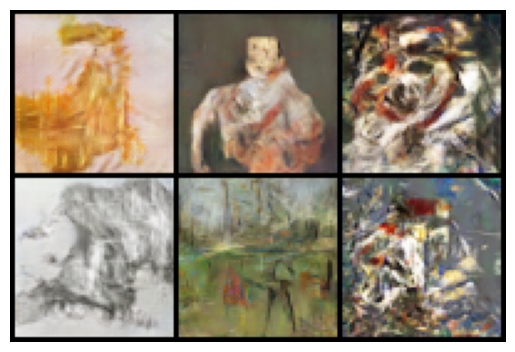

Epoch [84/100], Discriminator Loss: 1.0647, Generator Loss: 1.1994


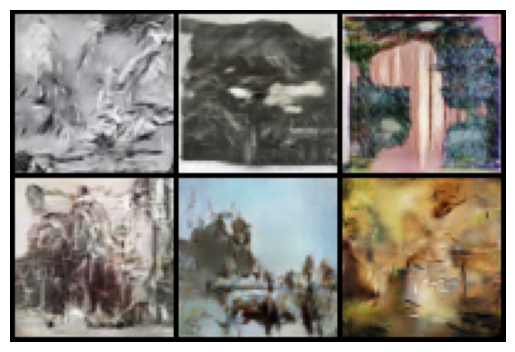

Epoch [85/100], Discriminator Loss: 1.0611, Generator Loss: 1.2026


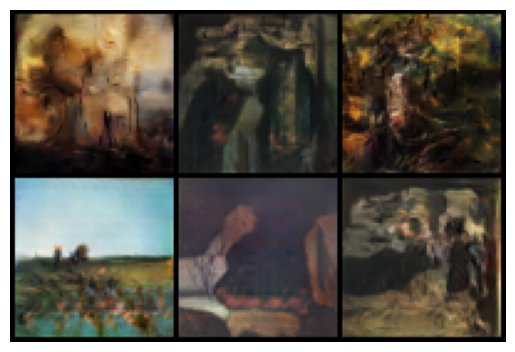

Epoch [86/100], Discriminator Loss: 1.0603, Generator Loss: 1.2077


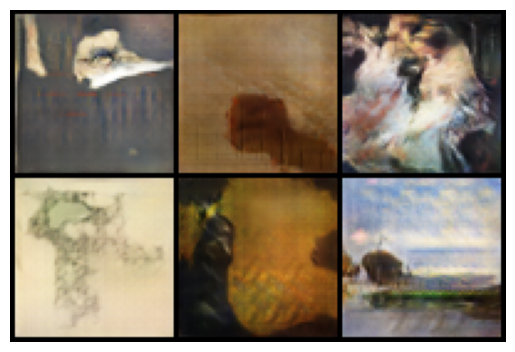

Epoch [87/100], Discriminator Loss: 1.0529, Generator Loss: 1.2186


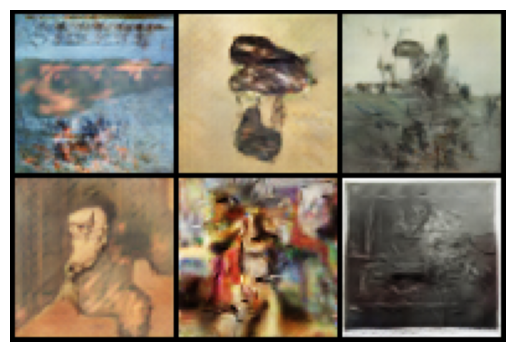

Epoch [88/100], Discriminator Loss: 1.0917, Generator Loss: 1.2323


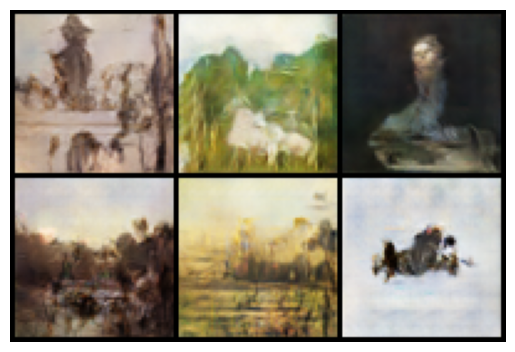

Epoch [89/100], Discriminator Loss: 1.0467, Generator Loss: 1.1969


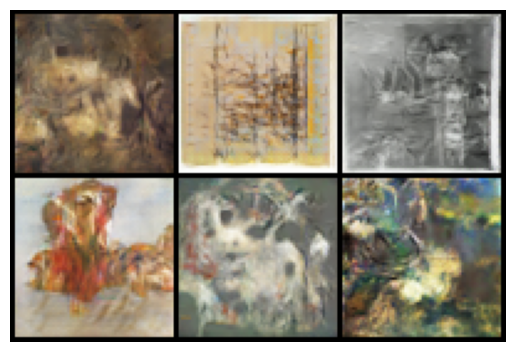

Epoch [90/100], Discriminator Loss: 1.0487, Generator Loss: 1.2174


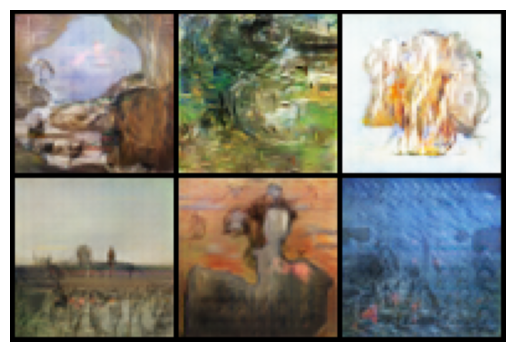

Epoch [91/100], Discriminator Loss: 1.0462, Generator Loss: 1.2302


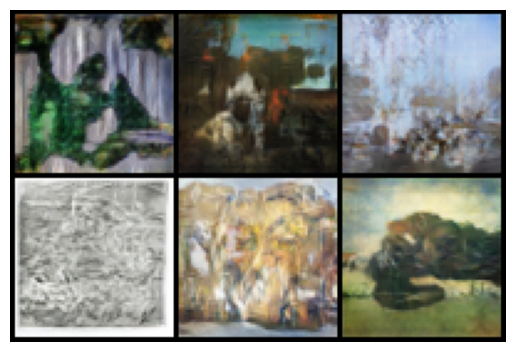

Epoch [92/100], Discriminator Loss: 1.0400, Generator Loss: 1.2396


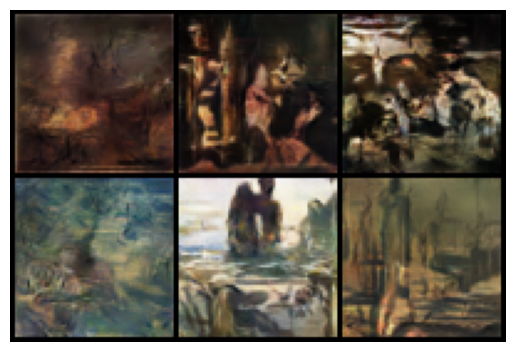

Epoch [93/100], Discriminator Loss: 1.0428, Generator Loss: 1.2358


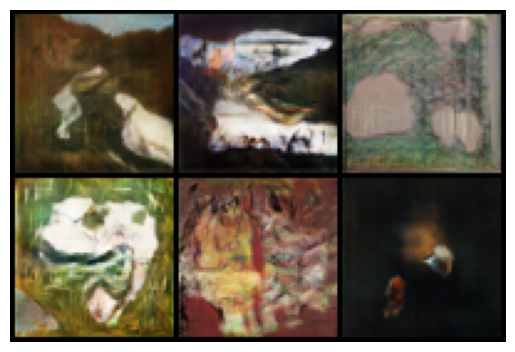

Epoch [94/100], Discriminator Loss: 1.0857, Generator Loss: 1.2094


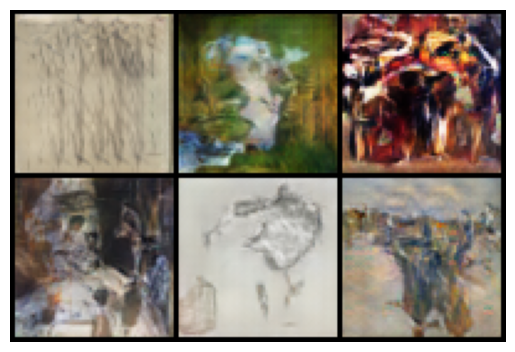

Epoch [95/100], Discriminator Loss: 1.0400, Generator Loss: 1.2381


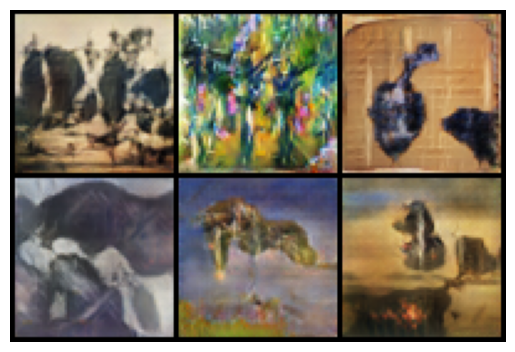

Epoch [96/100], Discriminator Loss: 1.0374, Generator Loss: 1.2450


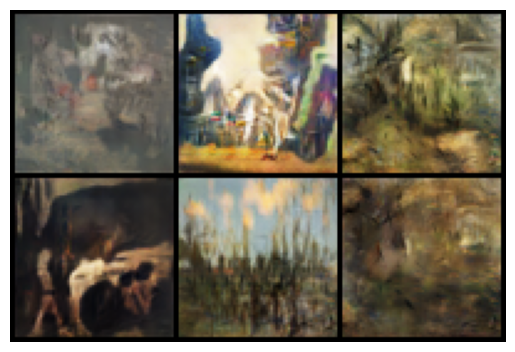

Epoch [97/100], Discriminator Loss: 1.0697, Generator Loss: 1.2291


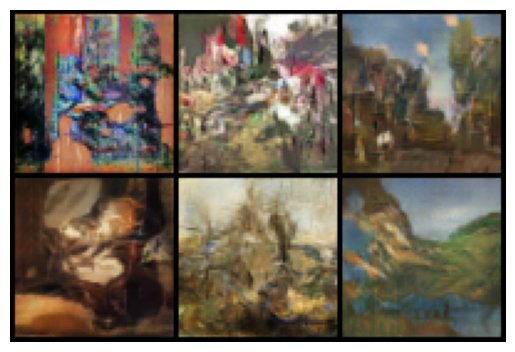

Epoch [98/100], Discriminator Loss: 1.0408, Generator Loss: 1.2425


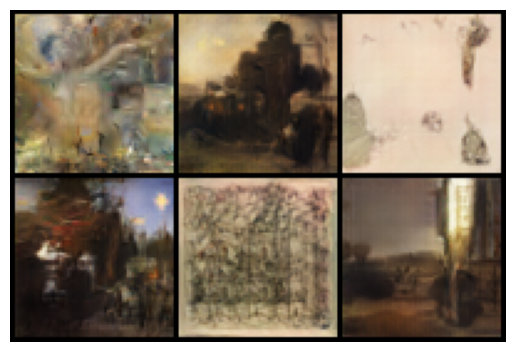

Epoch [99/100], Discriminator Loss: 1.0365, Generator Loss: 1.2605


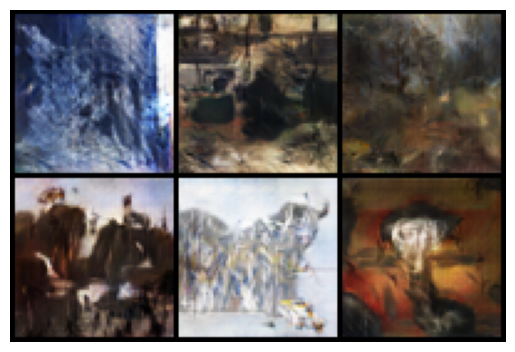

Epoch [100/100], Discriminator Loss: 1.0372, Generator Loss: 1.2536


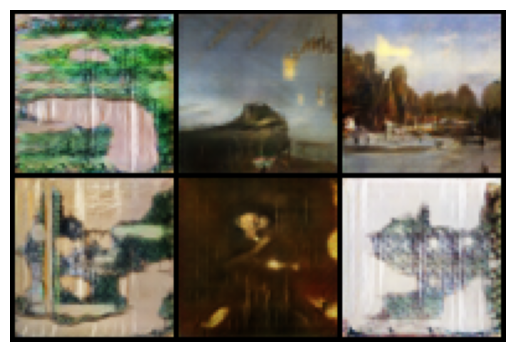

In [50]:
g_loss_h= []
d_loss_h = []
train(dataloader, nb_epochs, batch_size, generator, discriminator, 100, device)

In [51]:
torch.save(generator.state_dict(), 'generator_best.pth')

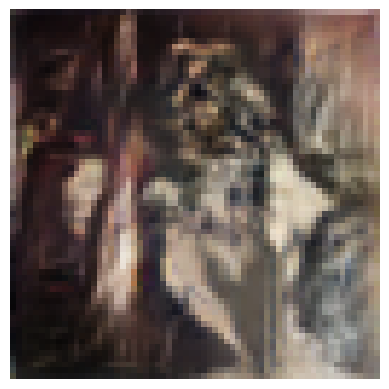

In [64]:
img = torch.randn(1, 100).to(device)
generated_img = generator(img)
img_scaled = (generated_img + 1) / 2
img_final = img_scaled * 255
img_np = img_final.detach().cpu().squeeze().numpy().transpose(1, 2, 0)

plt.imshow(img_np.astype('uint8'))
plt.axis("off")
plt.show()


Text(0, 0.5, 'Loss')

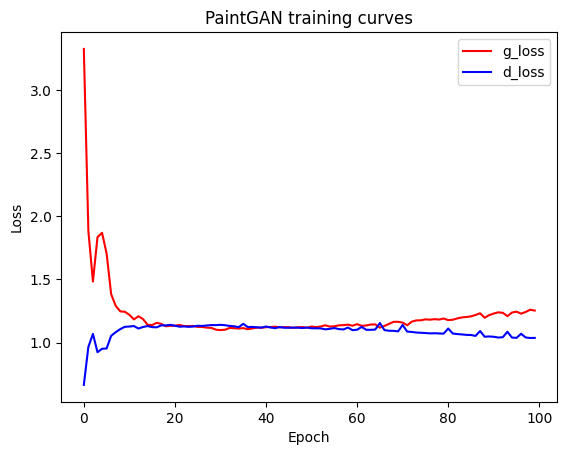

In [66]:
plt.plot(g_loss_h, c="red", label="g_loss")
plt.plot(d_loss_h, c="blue", label="d_loss")
plt.title("PaintGAN training curves")
plt.legend()
plt.xlabel("Epoch")
plt.ylabel("Loss")